In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/fashionmnist/t10k-labels-idx1-ubyte
/kaggle/input/fashionmnist/t10k-images-idx3-ubyte
/kaggle/input/fashionmnist/fashion-mnist_test.csv
/kaggle/input/fashionmnist/fashion-mnist_train.csv
/kaggle/input/fashionmnist/train-labels-idx1-ubyte
/kaggle/input/fashionmnist/train-images-idx3-ubyte


In [ ]:
#importing libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from keras.models import Sequential
from keras.layers import Conv2D, Activation, MaxPool2D, Flatten, Dense, GlobalAveragePooling2D, Dropout
from sklearn.model_selection import KFold, train_test_split
from tensorflow.keras.utils import to_categorical
import tensorflow as tf
from tensorflow import keras
from kerastuner import RandomSearch
from kerastuner.engine.hyperparameters import HyperParameters

In [ ]:
#load train data
df = pd.read_csv('/kaggle/input/fashionmnist/fashion-mnist_train.csv')
df.head()

,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,...,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,pixel784
0,2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,9,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,6,0,0,0,0,0,0,0,5,0,...,0,0,0,30,43,0,0,0,0,0
3,0,0,0,0,1,2,0,0,0,0,...,3,0,0,0,0,1,0,0,0,0
4,3,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
#print dimension of the data
df.shape

(60000, 785)

#preprocessing and visualization

In [ ]:
#check missing values
df.isna().sum().sort_values()

label       0
pixel517    0
pixel518    0
pixel519    0
pixel520    0
           ..
pixel264    0
pixel265    0
pixel266    0
pixel268    0
pixel784    0
Length: 785, dtype: int64

In [ ]:
#check duplicated data
df.duplicated().any()

True

In [ ]:
#display number of duplicated data
df.duplicated().sum()

43

In [ ]:
#drop duplicates 
df = df.drop_duplicates()
df.shape

(59957, 785)

In [ ]:
#display some data info
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 59957 entries, 0 to 59999
Columns: 785 entries, label to pixel784
dtypes: int64(785)
memory usage: 359.5 MB


In [ ]:
#display the type of data
df.dtypes.unique()

array([dtype('int64')], dtype=object)

In [ ]:
#data describtion to know some statistical information about it
df.describe()

,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,...,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,pixel784
count,59957.000000,59957.000000,59957.000000,59957.000000,59957.000000,59957.000000,59957.000000,59957.000000,59957.000000,59957.000000,...,59957.000000,59957.000000,59957.000000,59957.000000,59957.000000,59957.000000,59957.000000,59957.000000,59957.000000,59957.000000
mean,4.500409,0.000901,0.006154,0.035342,0.102006,0.248094,0.411762,0.805744,2.197325,5.677802,...,34.620695,23.294528,16.581634,17.846190,22.799039,17.908901,8.523859,2.755275,0.856130,0.070300
std,2.872572,0.094723,0.271108,1.222756,2.453749,4.308444,5.838271,8.217037,14.090882,23.816347,...,57.546358,48.852671,41.974171,43.933567,51.815466,45.152503,29.622113,17.403733,9.360287,2.126631
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,5.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,58.000000,9.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,9.000000,16.000000,36.000000,226.000000,164.000000,227.000000,230.000000,224.000000,255.000000,254.000000,...,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,170.000000


In [ ]:
#plot correlation between columns
corr=df.corr()
corr.style.background_gradient(cmap='coolwarm')

<AxesSubplot:>

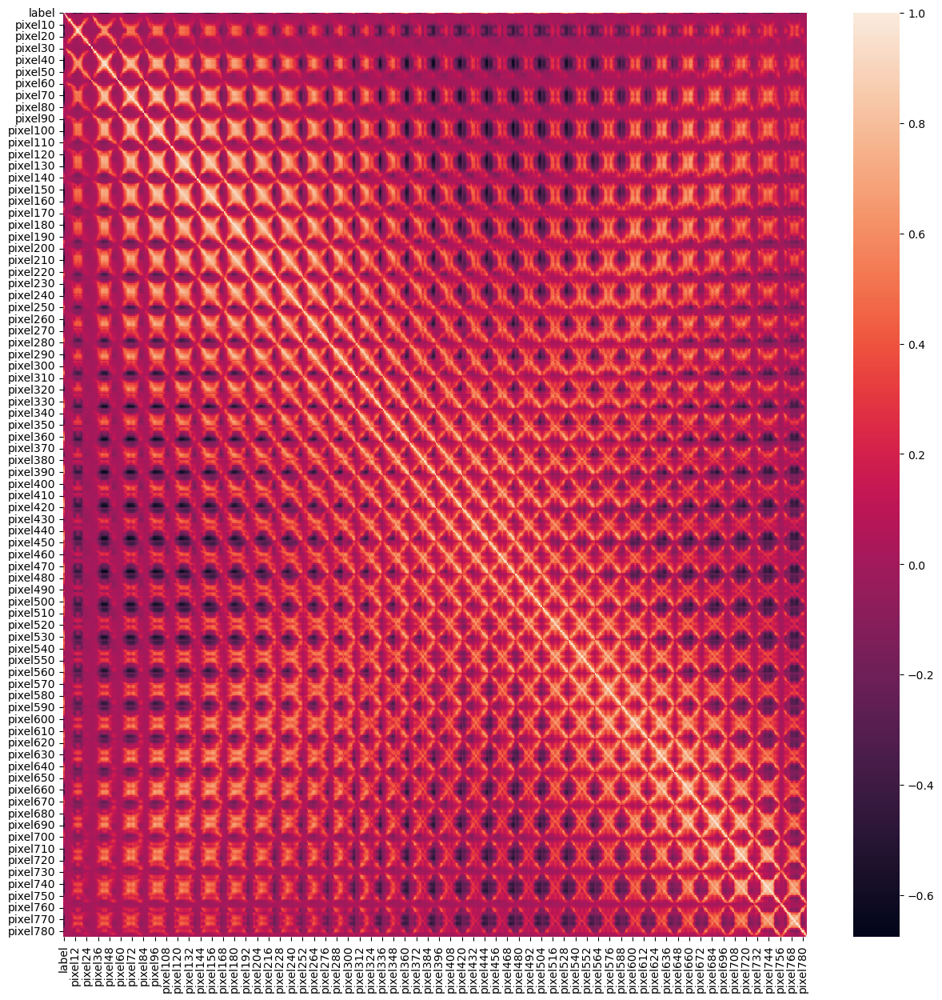

In [ ]:
#display the heatmap to represent correlation intensity
plt.figure(figsize=(15,15))
sns.heatmap(data=df.corr())

<AxesSubplot:>

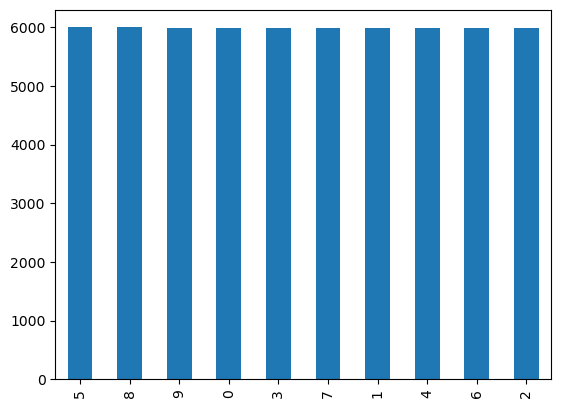

In [ ]:
#plot the count of labels for each class for the data
df['label'].value_counts().plot(kind='bar')

In [ ]:
#assign the label to y variable and x to the pixels
y = df["label"]
X = df.drop(["label"], axis =1)

In [ ]:
#view the pixels value to the first image 
X.iloc[0]

pixel1      0
pixel2      0
pixel3      0
pixel4      0
pixel5      0
           ..
pixel780    0
pixel781    0
pixel782    0
pixel783    0
pixel784    0
Name: 0, Length: 784, dtype: int64

In [ ]:
#array of pixels
tab = np.array(X)

# reshape the array into (28,28) pixel
images = tab.reshape(len(tab),28,28)

#check image dimension
images.shape

(59957, 28, 28)

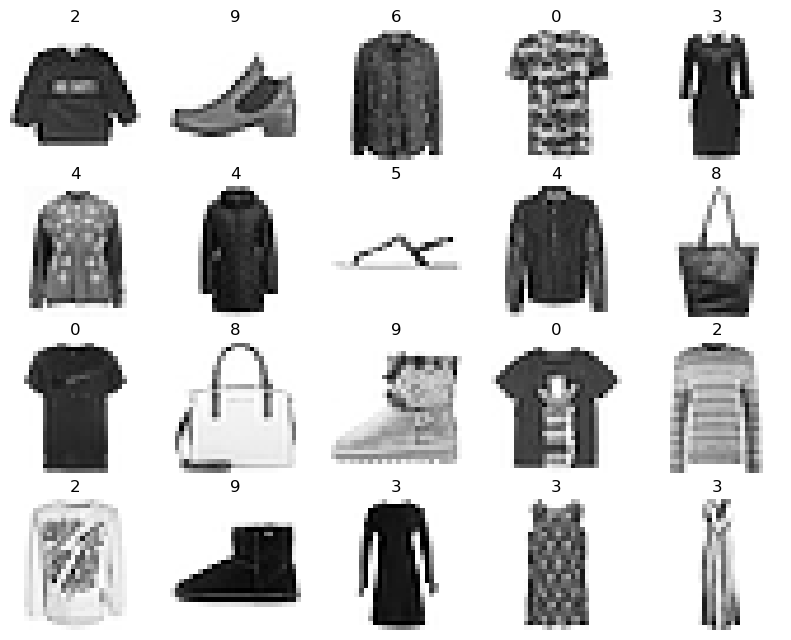

In [ ]:
#display first 20 images from the data
plt.figure(figsize=(10,20))
for i in range (0,20):
    plt.subplot(10,5,i+1)
    plt.imshow(images[i],cmap="Greys")
    plt.axis(False)
    plt.title(y[i])

In [ ]:
#normalize image pixels and encode its label
X_train = (X.values.reshape(59957,28,28,1))/255
y_train = to_categorical(y)

In [ ]:
#split data into tain and validation
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42)

#print splits dimension
print(X_train.shape)
print(X_val.shape)
print(y_train.shape)
print(y_val.shape)

(47965, 28, 28, 1)
(11992, 28, 28, 1)
(47965, 10)
(11992, 10)


#LENET model

In [ ]:
#LENET architecture
model = Sequential()
model.add(Conv2D(6, (5,5),activation='relu',input_shape=(28,28,1)))
model.add(MaxPool2D((2,2)))
model.add(Conv2D(16, (5,5), activation='relu'))
model.add(MaxPool2D((2,2)))
model.add(Flatten())
model.add(Dense(120, activation='relu'))
model.add(Dense(84, activation='relu'))
model.add(Dense(10, activation='softmax'))

In [ ]:
#show model summery
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 24, 24, 6)         156       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 12, 12, 6)        0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 8, 8, 16)          2416      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 4, 4, 16)         0         
 2D)                                                             
                                                                 
 flatten_7 (Flatten)         (None, 256)               0         
                                                                 
 dense_19 (Dense)            (None, 120)               3

In [ ]:
#model compilation
model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy"])

In [ ]:
# Train the model with early stopping based on validation loss
history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=20, batch_size=128, verbose=1) 

Epoch 1/20
375/375 [==============================] - 5s 6ms/step - loss: 0.7140 - accuracy: 0.7408 - val_loss: 0.5283 - val_accuracy: 0.8000
Epoch 2/20
375/375 [==============================] - 2s 5ms/step - loss: 0.4660 - accuracy: 0.8304 - val_loss: 0.4297 - val_accuracy: 0.8428
Epoch 3/20
375/375 [==============================] - 2s 5ms/step - loss: 0.4092 - accuracy: 0.8527 - val_loss: 0.3961 - val_accuracy: 0.8572
Epoch 4/20
375/375 [==============================] - 2s 5ms/step - loss: 0.3744 - accuracy: 0.8646 - val_loss: 0.3867 - val_accuracy: 0.8591
Epoch 5/20
375/375 [==============================] - 2s 5ms/step - loss: 0.3463 - accuracy: 0.8748 - val_loss: 0.3521 - val_accuracy: 0.8734
Epoch 6/20
375/375 [==============================] - 2s 5ms/step - loss: 0.3311 - accuracy: 0.8808 - val_loss: 0.3434 - val_accuracy: 0.8753
Epoch 7/20
375/375 [==============================] - 2s 5ms/step - loss: 0.3162 - accuracy: 0.8837 - val_loss: 0.3402 - val_accuracy: 0.8790
Epoch 

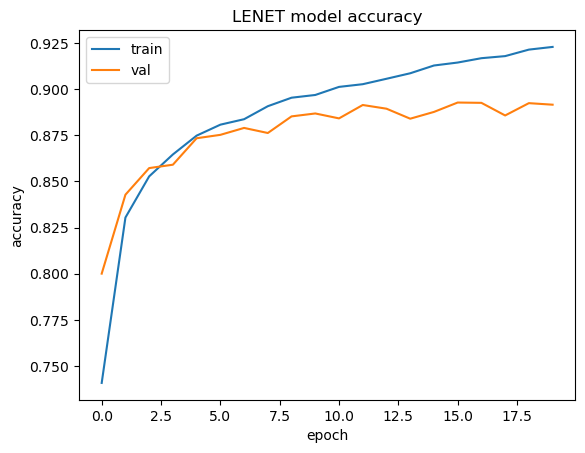

In [ ]:
#plot model accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('LENET model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

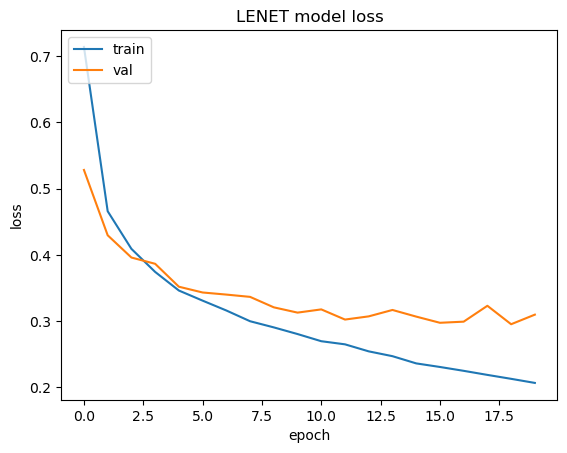

In [ ]:
#plot model loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('LENET model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

#LENET with modified hyperparameters

In [ ]:
#build a function which has lenet model architecture and tuner trying to achive best performance
# tuner try to tune the number of nurens in the first dense layer and values of learning rat
def build_model(hp):
    modell = Sequential()
    modell.add(Conv2D(6, (5,5),activation='relu',input_shape=(28,28,1)))
    modell.add(MaxPool2D((2,2)))
    modell.add(Conv2D(16, (5,5), activation='relu'))
    modell.add(MaxPool2D((2,2)))
    modell.add(Flatten())
    
    modell.add(Dense(units=hp.Int('dense_units', min_value=64, max_value=128, step=16),activation='relu'))
    modell.add(Dense(84, activation='relu'))
    modell.add(Dense(10, activation='softmax'))
    
    modell.compile(optimizer=keras.optimizers.Adam(hp.Choice('learning_rate', values=[1e-2, 1e-3])),
              loss='categorical_crossentropy',
              metrics=['accuracy'])
    return modell

In [ ]:
#perform tuner on the model 
tuner_search=RandomSearch(build_model,objective='val_accuracy',max_trials=5,directory='output',project_name="Mnist Fashion")

In [ ]:
#strart searching for the best hyperparameter
tuner_search.search(X_train, y_train,validation_data=(X_val, y_val),epochs=5)

Trial 5 Complete [00h 00m 39s]
val_accuracy: 0.8815043568611145

Best val_accuracy So Far: 0.8815043568611145
Total elapsed time: 00h 04m 14s


In [ ]:
#get and print the best values for the hyperparameters
best_hp = tuner_search.get_best_hyperparameters(num_trials = 1)[0]
print(best_hp.get('dense_units'),best_hp.get('learning_rate'))

112 0.001


In [ ]:
#tain model with the best hyperparameters which are tuned by tuner
model_with_besthdf = tuner_search.hypermodel.build(best_hp)
history_2 = model_with_besthdf.fit(X_train, y_train,validation_data=(X_val, y_val),epochs=8)

val_acc = history_2.history['val_accuracy']
best_epoch = val_acc.index(max(val_acc)) + 1
print((best_epoch,))

Epoch 1/8
1499/1499 [==============================] - 9s 5ms/step - loss: 0.5816 - accuracy: 0.7851 - val_loss: 0.4672 - val_accuracy: 0.8233
Epoch 2/8
1499/1499 [==============================] - 7s 5ms/step - loss: 0.3890 - accuracy: 0.8593 - val_loss: 0.3728 - val_accuracy: 0.8585
Epoch 3/8
1499/1499 [==============================] - 7s 5ms/step - loss: 0.3356 - accuracy: 0.8775 - val_loss: 0.3630 - val_accuracy: 0.8647
Epoch 4/8
1499/1499 [==============================] - 7s 5ms/step - loss: 0.3100 - accuracy: 0.8868 - val_loss: 0.3208 - val_accuracy: 0.8800
Epoch 5/8
1499/1499 [==============================] - 7s 4ms/step - loss: 0.2843 - accuracy: 0.8970 - val_loss: 0.3030 - val_accuracy: 0.8900
Epoch 6/8
1499/1499 [==============================] - 7s 4ms/step - loss: 0.2659 - accuracy: 0.9023 - val_loss: 0.3077 - val_accuracy: 0.8838
Epoch 7/8
1499/1499 [==============================] - 7s 4ms/step - loss: 0.2491 - accuracy: 0.9086 - val_loss: 0.3093 - val_accuracy: 0.8848

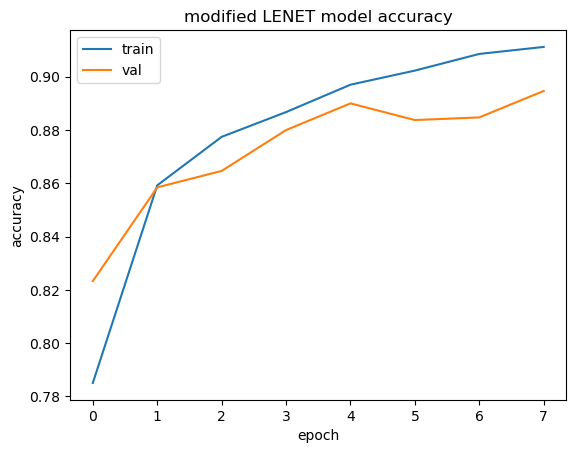

In [ ]:
#plot model accuracy
plt.plot(history_2.history['accuracy'])
plt.plot(history_2.history['val_accuracy'])
plt.title('modified LENET model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

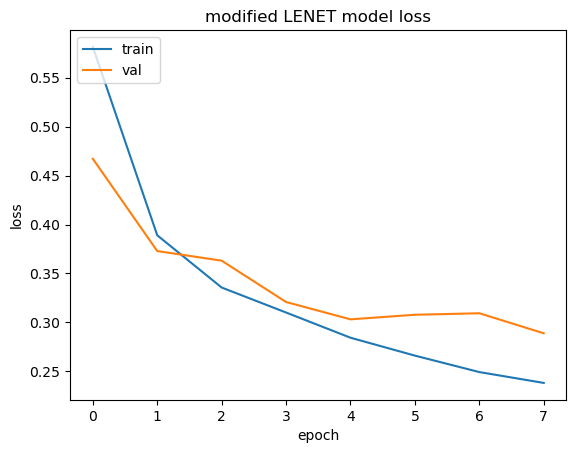

In [ ]:
#plot model loss
plt.plot(history_2.history['loss'])
plt.plot(history_2.history['val_loss'])
plt.title('modified LENET model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

#cross validation

In [ ]:
# Define the number of folds for cross-validation
k = 5

# Define the KFold cross-validation splitter
kf = KFold(n_splits=k, shuffle=True, random_state=42)

In [ ]:
# Initialize the list to store the cross-validation scores and histories
scores = []
histories = []

# Run cross-validation
for train_idx, val_idx in kf.split(X_train, y_train):
    # Get the training and validation data for this fold
    X_train_fold = X_train[train_idx]
    y_train_fold = y_train[train_idx]
    X_val_fold = X_train[val_idx]
    y_val_fold = y_train[val_idx]
    
    # Train the model on the training data for this fold
    model_with_besthdf.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy"])
    history_3 = model_with_besthdf.fit(X_train_fold, y_train_fold, validation_data=(X_val_fold, y_val_fold),epochs=30, batch_size=128,verbose=1)
    
    # Evaluate the model on the validation data for this fold and store the score
    eval_loss, eval_accuracy = model_with_besthdf.evaluate(X_val_fold, y_val_fold)
    histories.append(history_3)
    scores.append(eval_accuracy)
    print("_"*80)

Epoch 1/30
300/300 [==============================] - 3s 6ms/step - loss: 0.0674 - accuracy: 0.9832 - val_loss: 0.0132 - val_accuracy: 0.9956
Epoch 2/30
300/300 [==============================] - 2s 6ms/step - loss: 0.0085 - accuracy: 0.9970 - val_loss: 0.0070 - val_accuracy: 0.9969
Epoch 3/30
300/300 [==============================] - 2s 5ms/step - loss: 0.0051 - accuracy: 0.9986 - val_loss: 0.0299 - val_accuracy: 0.9919
Epoch 4/30
300/300 [==============================] - 2s 5ms/step - loss: 0.0277 - accuracy: 0.9914 - val_loss: 0.0462 - val_accuracy: 0.9849
Epoch 5/30
300/300 [==============================] - 2s 5ms/step - loss: 0.0189 - accuracy: 0.9934 - val_loss: 0.0219 - val_accuracy: 0.9916
Epoch 6/30
300/300 [==============================] - 1s 5ms/step - loss: 0.0140 - accuracy: 0.9951 - val_loss: 0.0473 - val_accuracy: 0.9854
Epoch 7/30
300/300 [==============================] - 1s 5ms/step - loss: 0.0248 - accuracy: 0.9920 - val_loss: 0.0351 - val_accuracy: 0.9886
Epoch 

In [ ]:
#define a function to plot accuracy and loss for each fold
def display_kfold_result(history, k=1):
    # Train & Val Loss
    loss = history.history["loss"]
    val_loss = history.history["val_loss"]
    
    # Train & Val Accuracy
    accuracy = history.history["accuracy"]
    val_accuracy = history.history["val_accuracy"]
    
    plt.figure(figsize=(15, 5))
    
    plt.subplot(1, 2, 1)
    plt.title("Loss")
    plt.plot(loss, label="Training")
    plt.plot(val_loss, label="Validation")
    plt.legend(loc="upper right")
    
    plt.subplot(1, 2, 2)
    plt.title("Accuracy")
    plt.plot(accuracy, label="Training")
    plt.plot(val_accuracy, label="Validation")
    plt.legend(loc="lower right")
    
    plt.suptitle("Fold-{}".format(k))
    plt.show()

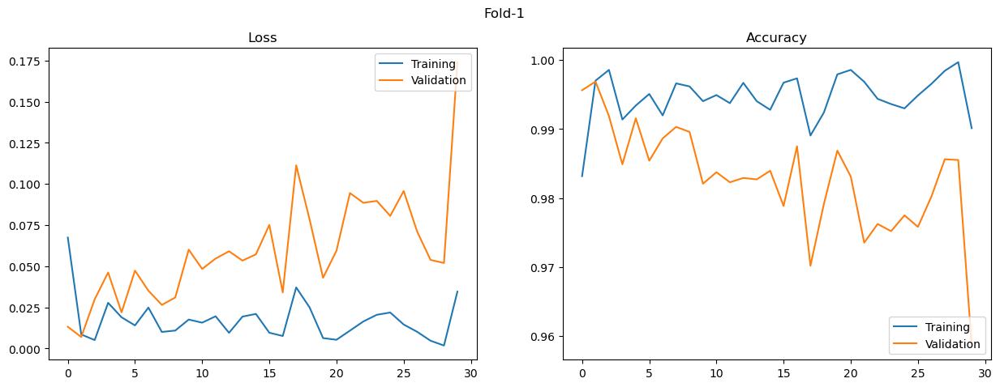

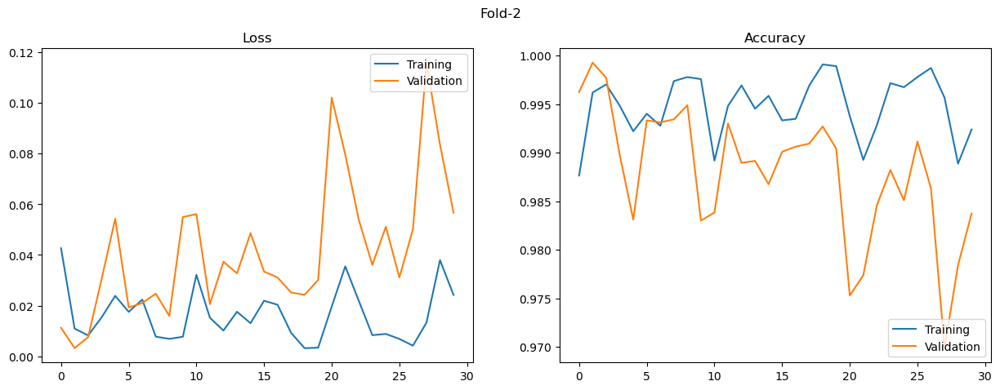

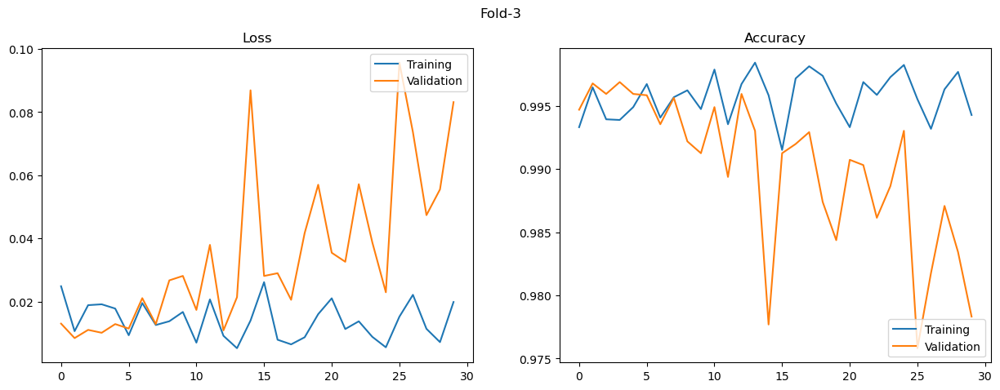

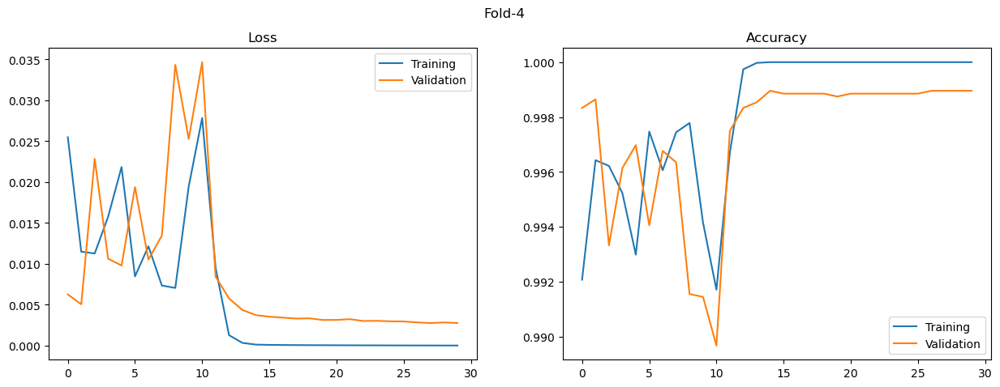

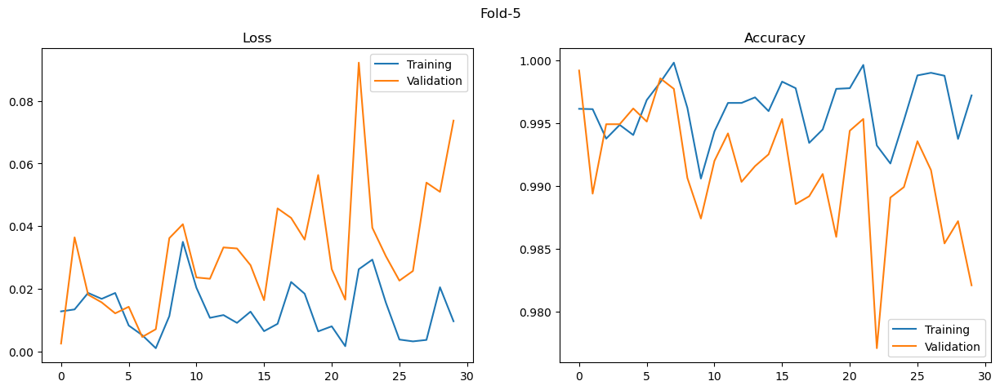

In [ ]:
# Displaying the graph results
for history in histories:
    display_kfold_result(history, (histories.index(history)+1))

#VGG model

In [ ]:
#reassign x and y
y = df["label"]
X = df.drop(["label"], axis =1)

#resplit the data into train and validation
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

#print dimension for X_train, X_val, y_train, y_val
print(X_train.shape)
print(X_val.shape)
print(y_train.shape)
print(y_val.shape)

(47965, 784)
(11992, 784)
(47965,)
(11992,)


In [ ]:
X_train = (X_train.values.reshape(len(X_train),28,28,1))/255
X_train = tf.image.resize(X_train, [32,32]) # if we want to resize 

X_val = (X_val.values.reshape(11992,28,28,1))/255
X_val = tf.image.resize(X_val, [32,32]) # if we want to resize 

y_train = to_categorical(y_train)
y_val = to_categorical(y_val)


# Convert to RGB images with shape (num_samples, height, width, 3)
X_train = np.repeat(X_train, 3, axis=-1)
X_val = np.repeat(X_val, 3, axis=-1)

In [ ]:
print(X_train.shape)
print(X_val.shape)
print(y_train.shape)
print(y_val.shape)

(47965, 32, 32, 3)
(11992, 32, 32, 3)
(47965, 10)
(11992, 10)


In [ ]:
#import VGG model 
from keras.applications.vgg16 import VGG16
from keras.models import Model

model = VGG16(include_top=False, input_shape=(32,32,3), weights='imagenet')

# Freeze all the layers
for layer in model.layers[:]:
    layer.trainable = False
    
output = model.output
#flatten layer
output =Flatten()(output)
#Fully Connection Layers
# FC1
output =Dense(1024, activation="relu")(output)
# FC2
output =Dense(1024, activation="relu")(output)
# FC3
output =Dense(1024, activation="relu")(output)
#Dropout to avoid overfitting effect
output =Dropout(0.5)(output)
# FC4
output =Dense(512, activation="relu")(output)
# FC5
output =Dense(512, activation="relu")(output)
#Dropout to avoid overfitting effect
output =Dropout(0.4)(output)
# FC6
output =Dense(256, activation="relu")(output)
# FC7
output =Dense(64, activation="relu")(output)
# FC8
output =Dense(64, activation="relu")(output)
#Dropout to avoid overfitting effect
output =Dropout(0.2)(output)
#output layer
output =Dense(10,activation="softmax")(output)
model = Model(model.input, output)

In [ ]:
model.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_9 (InputLayer)        [(None, 32, 32, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 32, 32, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 32, 32, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 16, 16, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 16, 16, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 16, 16, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 8, 8, 128)         0   

In [ ]:
#VGG compilation and fit
model.compile(optimizer='adam',loss='categorical_crossentropy', metrics=['accuracy'])
history_4 = model.fit(X_train, y_train,validation_data=(X_val, y_val),epochs=20, batch_size=32)

Epoch 1/20
1499/1499 [==============================] - 20s 12ms/step - loss: 0.7268 - accuracy: 0.7457 - val_loss: 0.5333 - val_accuracy: 0.8160
Epoch 2/20
1499/1499 [==============================] - 19s 13ms/step - loss: 0.5119 - accuracy: 0.8308 - val_loss: 0.4744 - val_accuracy: 0.8360
Epoch 3/20
1499/1499 [==============================] - 17s 11ms/step - loss: 0.4661 - accuracy: 0.8435 - val_loss: 0.4346 - val_accuracy: 0.8410
Epoch 4/20
1499/1499 [==============================] - 19s 13ms/step - loss: 0.4363 - accuracy: 0.8513 - val_loss: 0.4394 - val_accuracy: 0.8415
Epoch 5/20
1499/1499 [==============================] - 19s 13ms/step - loss: 0.4175 - accuracy: 0.8562 - val_loss: 0.4572 - val_accuracy: 0.8371
Epoch 6/20
1499/1499 [==============================] - 17s 11ms/step - loss: 0.3947 - accuracy: 0.8636 - val_loss: 0.4293 - val_accuracy: 0.8623
Epoch 7/20
1499/1499 [==============================] - 17s 11ms/step - loss: 0.3846 - accuracy: 0.8666 - val_loss: 0.3956 -

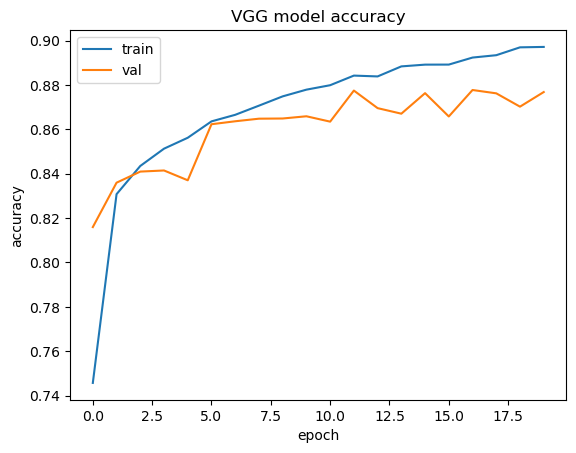

In [ ]:
#plot model accuracy
plt.plot(history_4.history['accuracy'])
plt.plot(history_4.history['val_accuracy'])
plt.title('VGG model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

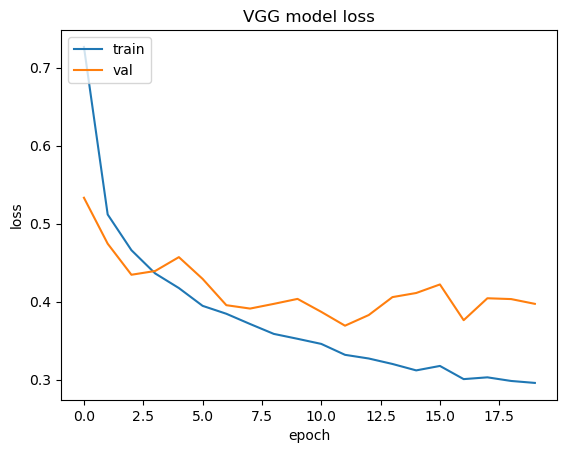

In [ ]:
#plot model loss
plt.plot(history_4.history['loss'])
plt.plot(history_4.history['val_loss'])
plt.title('VGG model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

#ResNet model

In [ ]:
#import ResNet50
from tensorflow.keras.applications.resnet50 import ResNet50
from keras.layers import  GlobalAveragePooling2D


model = ResNet50(include_top=False, input_shape=(32,32,3), weights='imagenet')

# Freeze all the layers
for layer in model.layers[:]:
    layer.trainable = False
     
# Add Dense layer 
output = model.output
output = GlobalAveragePooling2D()(output)
output = Dense(units=10, activation='softmax')(output)
model = Model(model.input, output)

In [ ]:
model.summary()

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_12 (InputLayer)          [(None, 32, 32, 3)]  0           []                               
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 38, 38, 3)    0           ['input_12[0][0]']               
                                                                                                  
 conv1_conv (Conv2D)            (None, 16, 16, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalization)  (None, 16, 16, 64)   256         ['conv1_conv[0][0]']             
                                                                                            

In [ ]:
model.compile(optimizer='adam',loss='categorical_crossentropy', metrics=['accuracy'])
history_5 = model.fit(X_train, y_train,validation_data=(X_val, y_val),epochs=20, batch_size=32)

Epoch 1/20
1499/1499 [==============================] - 31s 18ms/step - loss: 1.1031 - accuracy: 0.6222 - val_loss: 0.8445 - val_accuracy: 0.7057
Epoch 2/20
1499/1499 [==============================] - 25s 17ms/step - loss: 0.7961 - accuracy: 0.7150 - val_loss: 0.7246 - val_accuracy: 0.7473
Epoch 3/20
1499/1499 [==============================] - 26s 17ms/step - loss: 0.7291 - accuracy: 0.7369 - val_loss: 0.7838 - val_accuracy: 0.7036
Epoch 4/20
1499/1499 [==============================] - 25s 17ms/step - loss: 0.6953 - accuracy: 0.7462 - val_loss: 0.6712 - val_accuracy: 0.7603
Epoch 5/20
1499/1499 [==============================] - 26s 17ms/step - loss: 0.6706 - accuracy: 0.7547 - val_loss: 0.6485 - val_accuracy: 0.7615
Epoch 6/20
1499/1499 [==============================] - 26s 17ms/step - loss: 0.6529 - accuracy: 0.7594 - val_loss: 0.6659 - val_accuracy: 0.7447
Epoch 7/20
1499/1499 [==============================] - 26s 17ms/step - loss: 0.6366 - accuracy: 0.7690 - val_loss: 0.6307 -

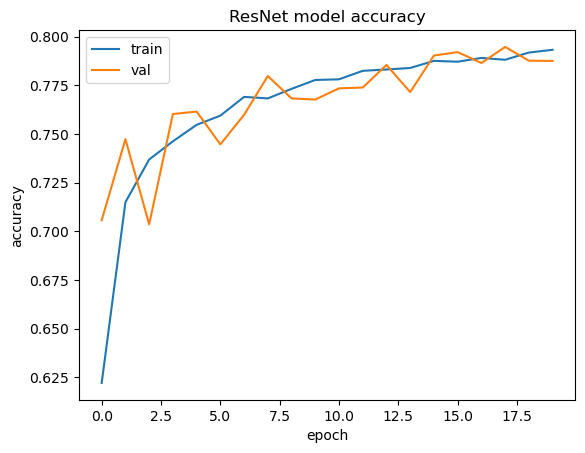

In [ ]:
#plot model accuracy
plt.plot(history_5.history['accuracy'])
plt.plot(history_5.history['val_accuracy'])
plt.title('ResNet model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

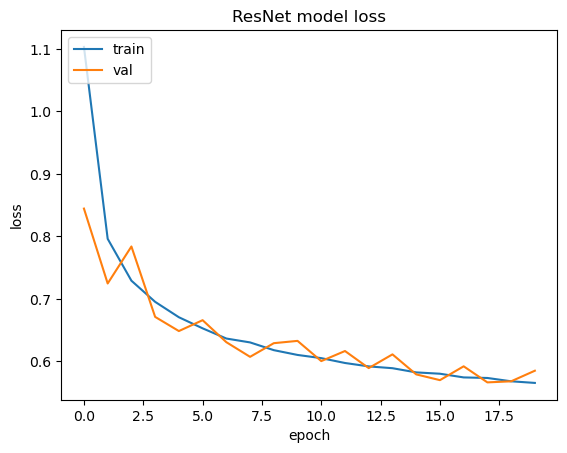

In [ ]:
#plot model loss
plt.plot(history_5.history['loss'])
plt.plot(history_5.history['val_loss'])
plt.title('ResNet model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()